---
title: "Spectral Graphs & Poly2Graph — A Hands‑On Tutorial"
author: "Yiyang Liu"
date: today
format:
  html:
    toc: true
    number-sections: true
    code-fold: false
jupyter: python3
execute:
  echo: true
  warning: true
  message: false
---


## Learning objectives
By the end of this tutorial, you will be able to:

- Explain what a **spectral graph** is (a graph traced by the energy spectrum of a 1‑D crystal on the complex plane under open boundaries).
- Understand the **key mathematical objects** that appear in modern treatments: the **characteristic polynomial** $P(z,E)$, the **spectral potential** $\Phi(E)$, and the **density of states** $\rho(E)$.
- Describe prior **pain points** (manual inspection, numerical bottlenecks, fragile extraction) and the need for an **automated** tool.
- Use **Poly2Graph** to go from a symbolic Hamiltonian/characteristic polynomial to its spectral graph, and analyze/visualize the result.

## What is a spectral graph (and why is it interesting)? {#sec-session-1}

**Basic idea :**  

Consider a simple 1‑D crystal (a line of repeating “cells”). Its energy levels $E$ depend on a wavelike parameter $k$ (momentum). A 1‑D non‑Hermitian system is **a tight‑binding chain** whose effective Hamiltonian $H$ is not equal to its adjoint **($H \neq H^{\dagger}$)**, e.g., due to asymmetric couplings, gain/loss, or non‑reciprocal driving. Consequently, eigenenergies are generally complex ($E \in \mathbb{C}$) and right/left eigenvectors differ (biorthogonality). \
In such one‑dimensional non‑Hermitian systems with a **point gap**, under **periodic** boundaries (“a loop”), energies trace **closed loops** as $k$ runs from $0$ to $2\pi$. \
Under **open** boundaries (“a finite chain”), something shocking can happen in non‑Hermitian systems (with loss/gain or non‑reciprocal couplings): the eigen‑energies **collapse** into **arcs and loops** assembled into a **planar spectral graph** embedded in the complex plane. Geometrically, OBC energies lie on intersection lines of inverse‑skin‑depth surfaces $\mathrm{Im}\,k=-\log|z|$ defined by $P(z,E)=0$: the intersection of two such surfaces produces an **edge**, and the intersection of three or more surfaces produces a **vertex**. To simply put, connect those arcs/loops and you get a **spectral graph**.

**Algebraic formulation:**

 Let $H(z)$ be the Bloch Hamiltonian with $z=e^{ik}$ and
$$
P(z,E)=\det\!\big[H(z)-EI\big]=\sum_{n=-p}^{q} a_n(E)\,z^n .
$$
For a fixed $E$, order the $z$‑roots of $P(z,E)=0$ by magnitude $|\beta_1(E)|\le\cdots\le|\beta_{p+q}(E)|$. The **generalized Brillouin zone (GBZ)** is characterized by the equality
$$
|\beta_p(E)|=|\beta_{p+1}(E)|,
$$
and the corresponding loci of $E$ form the OBC **spectral graph**. In particular, the **density of states (DOS)** in the continuum limit is supported *only along these loci* (as a singular distribution along curves, rather than an area region). In multi‑band systems there may also exist **isolated edge modes** outside the continuum spectral graph.

**Potential‑theoretic view:**

 A convenient **“spectral potential”** (Ronkin function) can be defined from the $z$‑roots; one common choice (up to an additive constant and a sign convention) is
$$
\Phi(E)=-\log|a_q(E)|-\sum_{i=p+1}^{p+q}\log|\beta_i(E)|.
$$
Its Laplacian yields the **density of states(DOS)**,
$$
\rho(E)=-\frac{1}{2\pi}\,\nabla^2\Phi(E),
$$
where the sign depends on the convention used for $\Phi$. In the **distributional** sense, $\rho(E)$ has support only on the spectral graph. Equivalently, the spectral graph coincides with the ridges/troughs of $\Phi(E)$ (depending on the sign convention).
  
**Intuition:** treat each eigenvalue $\epsilon_n$ as a tiny electric charge $\rho(E) = \lim_{N\to\infty}\sum_n \frac{1}{N} \delta(E-\epsilon_n)$; while $\Phi(E)$ is an electrostatic‑like potential whose “ridges/troughs” trace the spectral graph; $\rho(E)$ is nonzero **only on the graph**. 
Please see the @sec-ssh-example below for a concrete illustration.



**Why interesting?**

**Within Non‑Hermitian systems:**

 Non-Hermitian spectra can realize **many more** graph connectivities than standard topological labels (like $\mathbb{Z},\mathbb{Z}_2$): stars, flowers, braids, etc., with **novel transitions** that change the number of endpoints/junctions/loops (no Hermitian analog). This is naturally expressed by writing dispersions as bivariate Laurent polynomials $P(E,z)$ and studying how their imaginary‑momentum (“inverse skin depth”) surfaces intersect across the $E$‑plane. 

**Beyond Hamiltonians (algebra‑to‑graph):**

 Spectral graph is a general algebra-to-graph bridge. Because the equation $\Phi(E) = - \log|a_q(E)| - \sum_{i=p+1}^{p+q}\log|\beta_i(E)|$ uses only $P(E,z)$, the construction extends to **arbitrary Laurent polynomials**, and via standard reductions to **vectors** and **matrices**. You get a **universal topological fingerprint** for many algebraic objects—making **graph learning a front-door** to problems in linear algebra, signal processing, photonics, circuits, and more.

**Automation usage:**

 The Poly2Graph pipeline automates the construction above: it evaluates $z$‑roots via **Frobenius companion** eigen‑solvers with automatic backend detection (and optional GPU/TPU acceleration when TensorFlow or PyTorch is available), builds $\Phi(E)$ and $\rho(E)$ on an **adaptive grid**, and extracts a one‑pixel‑wide **skeleton** via morphological thinning to obtain a **NetworkX MultiGraph** with full edge geometry. In rare low‑DOS or long‑range multi‑band settings, local numerical instabilities can arise; Poly2Graph mitigates them with node‑merging and short‑edge contraction.

*Example.* Here, we visualize a single-band example by an interactive 3D surface plot of $\Phi(E)$ along with the extracted skeleton @fig-3d-surface.

##  What was hard before (and why we need Poly2Graph)? {#sec-session-2}

Prior to Poly2Graph, extracting spectral graphs was **manual** and **fragile**:

- You had to **scan parameters**, plot large finite‑chain spectra, and **visually** infer the continuum graph.
- Computing the GBZ roots $\beta_i(E)$ **for every** sampled energy $E$ is a bottleneck; naive solvers are slow and memory‑hungry.
- Even with a DOS image, turning that into a **clean graph** with correct endpoints, junctions, and loops requires careful morphology (thresholding, skeletonization, node/edge parsing).

**Poly2Graph** lifts these barriers with an end‑to‑end, high‑performance pipeline:

1. Accepts **either** $H(z)$ (as a `sympy.Matrix`) **or** $P(z,E)$ (string or `sympy.Poly`).  
2. Computes the **spectral potential** $\Phi(E)$ from $z$‑roots (fast eigen‑solvers on Frobenius companion matrices; optional GPU/TPU via TensorFlow/PyTorch).  
3. Takes the **Laplacian** to get DOS, then does **adaptive, two‑stage refinement** (coarse mask → high‑res on just ~1–5% of the region).  
4. Applies image **morphology** to extract a **one‑pixel skeleton**, then returns a **NetworkX MultiGraph** with *full edge geometry* (the sampled curve).  

This automation has enabled **HSG‑12M** (11.6M static + 5.1M temporal spectral multigraphs), demonstrating scale and diversity previously out of reach(Learn more from @arXiv:2506.08618 if interested).

***Now let's try to use Poly2Graph***

In [2]:
#| label: Import libs
#| fig-cap: "importing essential libraries"

# If running on devices without essential libraries, uncomment the next line:
# !pip install -U poly2graph sympy networkx matplotlib

import sympy as sp
import numpy as np
np.set_printoptions(threshold=20)
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import networkx as nx

# Poly2Graph (must be installed in your environment)
# If this import fails, run the pip command above.
import poly2graph as p2g

In [3]:
# For better plotly rendering in Jupyter environments
import plotly.io as pio
pio.renderers.default = "plotly_mimetype+notebook_connected"

Please ensure your version of `Python >= 3.11` , you can check the installation:

In [4]:
print("Poly2Graph version:", p2g.__version__)

Poly2Graph version: 0.2.0


In [5]:
# Always remember to define common symbols first
k = sp.symbols('k', real=True)
z, E = sp.symbols('z E', complex=True)

## 1. A quick start: One‑band example {#1-sec-quick-start}

We’ll start from a simple **one‑band** characteristic polynomial and obtain its spectral graph.

**Characteristic polynomial**
$
P(z,E) = z^4 - z^2 - z^{-1} - E
$
(This corresponds to a scalar Bloch Hamiltonian $h(z)=z^4-z^2-z^{-1}$, with $z=e^{ik}$.)


The valid input formats to initialize a `p2g.SpectralGraph` object are:
1. Characteristic polynomial in terms of `z` and `E`:
   - as a string of the Poly in terms of `z` and `E`
   - as a `sympy`'s `Poly` (`sympy.polys.polytools.Poly`) with {`z`, `1/z`, `E`} as generators
2. Bloch Hamiltonian in terms of `k` or `z`
   - as a `sympy` `Matrix` in terms of `k`
   - as a `sympy` `Matrix` in terms of `z`

All the following **characteristics** are valid and will initialize to the same characteristic polynomial and therefore produce the same spectral graph

In [6]:
char_poly_str = '-z**-1 - E - z**2 + z**4'

char_poly_Poly = sp.Poly(
    -z**-1 - E - z**2 + z**4,
    z, 1/z, E # generators are z, 1/z, E
)

phase_k = sp.exp(sp.I*k)
char_hamil_k = sp.Matrix([-phase_k**-1 - phase_k**2 + phase_k**4])

char_hamil_z = sp.Matrix([-z**-1 - E - z**2 + z**4])

Here we use the string format as the initialization example.

In [7]:
sg = p2g.SpectralGraph(char_poly_str, k=k, z=z, E=E)

In [8]:
# print the number of energy bands
print('Bands:', sg.num_bands)

# print the max hopping range (p,q)
print('Max hop (right):', sg.poly_p, 'Max hop (left):', sg.poly_q)

# print the [Ereal_min,Ereal_max,Eimag_min,Eimag_max] window
print('Spectral window (auto-estimated):', sg.spectral_square) 


Bands: 1
Max hop (right): 1 Max hop (left): 4
Spectral window (auto-estimated): [-2.31139048  1.6398687  -1.97562959  1.97562959]


We will see `Poly2Graph` automatically compute set of properties next:

In [9]:
sg.ChP

Poly(z**4 - z**2 - (1/z) - E, z, 1/z, E, domain='ZZ')

Bloch Hamiltonian:

- For one-band model(The exponent of $E$ is 1), it is a unique, rank-0 matrix (scalar)

In [10]:
sg.h_k

Matrix([[exp(4*I*k) - exp(2*I*k) - exp(-I*k)]])

or in $z$ format(recall that $z = e^{ik}$)

In [11]:
sg.h_z

Matrix([[-(-z**5 + z**3 + 1)/z]])

**Frobenius Companion Matrix of $P(z, E)$:**

- The Frobenius companion matrix is a special matrix whose eigenvalues are exactly the roots of the characteristic polynomial $P(z, E)$ for fixed $E$.
- In `Poly2Graph`, `sg.companion_E` gives this matrix (with $E$ as a parameter, $z$ as variable).
- **Purpose:**  
  - Efficiently computes all $z$-roots for any $E$ using linear algebra (eigenvalues), instead of slow root-finding.
  - These $z$-roots are essential for calculating the spectral graph, GBZ, spectral potential, and density of states.

In [12]:
sg.companion_E

Matrix([
[0, 0, 0, 0, 1],
[1, 0, 0, 0, E],
[0, 1, 0, 0, 0],
[0, 0, 1, 0, 1],
[0, 0, 0, 1, 0]])

 It is a **key tool** for automating and accelerating spectral graph extraction in `Poly2Graph`.


### Spectral potential $\Phi(E)$, density of states $\rho(E)$, and skeleton
We compute $\Phi(E)$ and $\rho(E)$ on a grid of complex energies, then binarize $\rho(E)$ to get a **skeleton**.


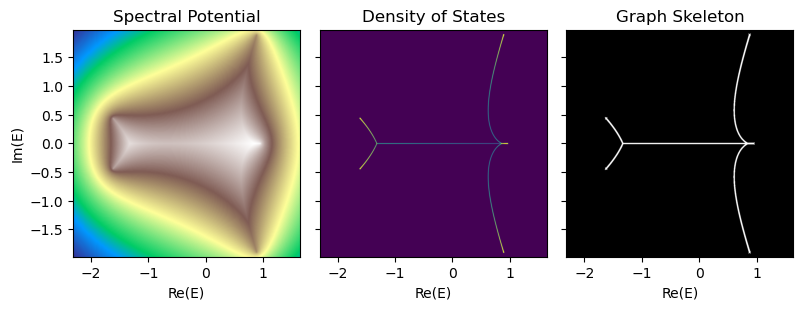

In [13]:
#| label: 1 band spectral images
#| fig-cap: "Spectral images for 1 band example: (1) Spectral potential Φ, (2) Density of States ρ, (3) Graph skeleton from ρ"

phi, dos, skel = sg.spectral_images()

fig, axes = plt.subplots(1, 3, figsize=(8, 3), sharex=True, sharey=True)

# 1) Spectral potential
axes[0].imshow(phi, extent=sg.spectral_square, origin='lower', cmap='terrain')
axes[0].set(xlabel='Re(E)', ylabel='Im(E)', title='Spectral Potential')

# 2) Density of States
pmin, pmax = np.percentile(dos, (0.1, 99.9))
# Clip extreme DOS to increase visibility
norm = colors.Normalize(vmin=pmin, vmax=pmax)
axes[1].imshow(dos, extent=sg.spectral_square, cmap='viridis', norm=norm)
axes[1].set(xlabel='Re(E)', title='Density of States')

# 3) Binarized skeleton
axes[2].imshow(skel, extent=sg.spectral_square, cmap='gray')
axes[2].set(xlabel='Re(E)', title='Graph Skeleton')
plt.tight_layout()
plt.savefig("assets/1-band-example_si.png")
plt.show()


### Extract the spectral graph
Next, we visualize these results by a interactive 3D surface plot of $\Phi(E)$ along with the extracted skeleton.

In [14]:
#| label: fig-3d-surface
#| fig-cap: "3D surface plot"

import plotly.graph_objects as go

E_re = np.linspace(*sg.spectral_square[:2], phi.shape[0])
E_im = np.linspace(*sg.spectral_square[2:], phi.shape[1])
fig = go.Figure(data=[go.Surface(z=phi, x=E_re, y=E_im, 
            opacity=0.6, colorscale='Spectral_r')])
fig.update_layout(
scene=dict(
    aspectratio=dict(x=1.5, y=1, z=.8),
    xaxis_title='Re(E)',yaxis_title='Im(E)',zaxis_title='Phi(E)',
),
title='3D Surface Plot of Spectral Potential',
width=700, height=600
)
fig.show()



`sg.spectral_graph()` returns a **NetworkX MultiGraph** with node positions and polyline geometry along each edge.


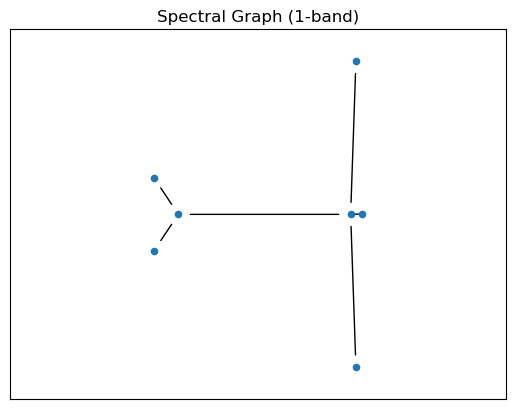

#nodes: 7  #edges: 6
A node has attributes: ['pos', 'dos', 'potential']
An edge has attributes: ['weight', 'pts', 'avg_dos', 'avg_potential']


In [15]:
#| label: 1 band spectral graph
#| fig-cap: "Spectral Graph (1-band)"

# Draw the multi-band spectral graph
G = sg.spectral_graph()
pos2 = nx.get_node_attributes(G, 'pos')
plt.figure()
nx.draw_networkx_nodes(G, pos2, node_size=20)
nx.draw_networkx_edges(G, pos2)
plt.axis('equal'); plt.title('Spectral Graph (1-band)')
plt.show()

print(f'#nodes: {G.number_of_nodes()}  #edges: {G.number_of_edges()}')

# Show attributes of a node and an edge
any_node = list(G.nodes(data=True))[0]
print('A node has attributes:', list(any_node[1].keys()))
any_edge = list(G.edges(keys=True, data=True))[0]
print('An edge has attributes:', list(any_edge[3].keys()))

As you can see above, the spectral graph is a `networkx.MultiGraph` object.

- Node Attributes
  1. `pos` : (2,)-numpy array
     - the position of the node $(\text{Re}(E), \text{Im}(E))$
  2. `dos` : float
     - the density of states at the node
  3. `potential` : float
     - the spectral potential at the node
- Edge Attributes
  1. `weight` : float
     - the weight of the edge, which is the **length** of the edge in the complex energy plane
  2. `pts` : (w, 2)-numpy array
     - the positions of the points constituting the edge, where `w` is the number of points along the edge, i.e., the length of the edge, equals `weight`
  3. `avg_dos` : float
     - the average density of states along the edge
  4. `avg_potential` : float
     - the average spectral potential along the edge

In [16]:
node_attr = dict(G.nodes(data=True))
edge_attr = list(G.edges(data=True))
print('The attributes of the first node\n', node_attr[0], '\n')
print('The attributes of the first edge\n', edge_attr[0][-1], '\n')

The attributes of the first node
 {'pos': array([0.88936098, 1.90810319]), 'dos': np.float32(0.25110298), 'potential': np.float32(-0.4699422)} 

The attributes of the first edge
 {'weight': np.float64(2.0950480742544872), 'pts': array([[0.88550233, 1.89652723],
       [0.88550233, 1.89266858],
       [0.88550233, 1.88880993],
       ...,
       [0.81990525, 0.01350528],
       [0.8237639 , 0.00964663],
       [0.8237639 , 0.00192933]]), 'avg_dos': np.float32(0.079228334), 'avg_potential': np.float32(-0.2639912)} 



## 2. A multi‑band example{#2-sec-multi-band}

Now consider a **four‑band** polynomial:

$$
P(z,E) = z^2 + z^{-2} + E z - E^4
$$

A possible Bloch Hamiltonian realization is:
 $$\textbf{h}(z)=\begin{pmatrix}
0 & 0 & 0 & z^2 + 1/z^2 \\
1 & 0 & 0 & z \\
0 & 1 & 0 & 0 \\
0 & 0 & 1 & 0 \\
\end{pmatrix}$$
Poly2Graph can work **directly** from the string/`sympy.Poly` as shown below.


In [17]:
# We start with a polynomial string
sg_multi = p2g.SpectralGraph("z**2 + 1/z**2 + E*z - E**4", k, z, E)

In [18]:
# print the number of energy bands
print('Bands:', sg_multi.num_bands)

# print the max hopping range (p,q)
print('Max hop (right):', sg_multi.poly_p, 'Max hop (left):', sg_multi.poly_q)

# print the [Ereal_min,Ereal_max,Eimag_min,Eimag_max] window
print('Spectral window (auto-estimated):', sg_multi.spectral_square)


Bands: 4
Max hop (right): 2 Max hop (left): 2
Spectral window (auto-estimated): [-1.40559546  1.40559546 -1.40559546  1.40559546]


In [19]:
sg_multi.ChP

Poly(z**2 + z*E + (1/z)**2 - E**4, z, 1/z, E, domain='ZZ')

In [20]:
sg_multi.h_k

Matrix([
[0, 0, 0, exp(2*I*k) + exp(-2*I*k)],
[1, 0, 0,                 exp(I*k)],
[0, 1, 0,                        0],
[0, 0, 1,                        0]])

In [21]:
sg_multi.h_z

Matrix([
[0, 0, 0, z**2 + z**(-2)],
[1, 0, 0,              z],
[0, 1, 0,              0],
[0, 0, 1,              0]])

In [22]:
sg_multi.companion_E

Matrix([
[0, 0, 0,   -1],
[1, 0, 0,    0],
[0, 1, 0, E**4],
[0, 0, 1,   -E]])


### Spectral potential $\Phi(E)$, density of states $\rho(E)$, and skeleton
Like the one-band example, we also compute $\Phi(E)$ and $\rho(E)$ on a grid of complex energies, then binarize $\rho(E)$ to get a **skeleton**.


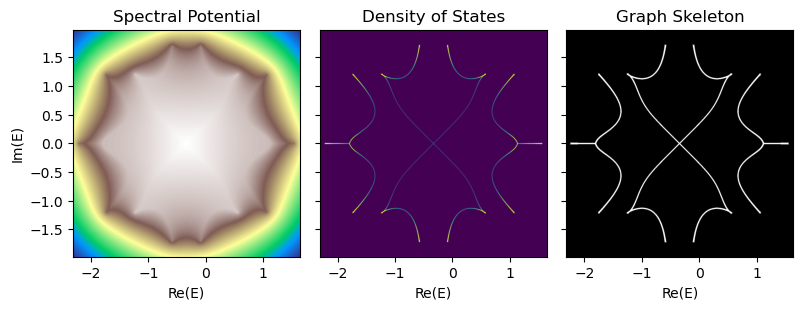

In [23]:
#| label: Multi-band spectral images
#| fig-cap: "Spectral images for multi-band example: (1) Spectral potential Φ, (2) Density of States ρ, (3) Graph skeleton from ρ"

phi2, dos2, skel2 = sg_multi.spectral_images()

fig, axes = plt.subplots(1, 3, figsize=(8, 3), sharex=True, sharey=True)

# 1) Spectral potential
axes[0].imshow(phi2, extent=sg.spectral_square, origin='lower', cmap='terrain')
axes[0].set(xlabel='Re(E)', ylabel='Im(E)', title='Spectral Potential')

# 2) Density of States
pmin, pmax = np.percentile(dos, (0.1, 99.9))
# Clip extreme DOS to increase visibility
norm = colors.Normalize(vmin=pmin, vmax=pmax)
axes[1].imshow(dos2, extent=sg.spectral_square, cmap='viridis', norm=norm)
axes[1].set(xlabel='Re(E)', title='Density of States')

# 3) Binarized skeleton
axes[2].imshow(skel2, extent=sg.spectral_square, cmap='gray')
axes[2].set(xlabel='Re(E)', title='Graph Skeleton')
plt.tight_layout()
plt.savefig("assets/multi-band-example_si.png")
plt.show()


### Extract the spectral graph


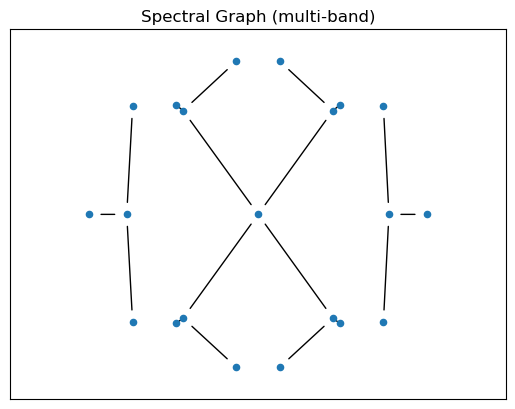

#nodes: 21  #edges: 18
A node has attributes: ['pos', 'dos', 'potential']
An edge has attributes: ['weight', 'pts', 'avg_dos', 'avg_potential']


In [24]:
#| label: Multi-band spectral graph
#| fig-cap: "Spectral Graph (multi‑band)"

# Draw the multi-band spectral graph
G2 = sg_multi.spectral_graph()
pos2 = nx.get_node_attributes(G2, 'pos')
plt.figure()
nx.draw_networkx_nodes(G2, pos2, node_size=20)
nx.draw_networkx_edges(G2, pos2)
plt.axis('equal'); plt.title('Spectral Graph (multi‑band)')
plt.show()

print(f'#nodes: {G2.number_of_nodes()}  #edges: {G2.number_of_edges()}')

# Show attributes of a node and an edge
any_node = list(G2.nodes(data=True))[0]
print('A node has attributes:', list(any_node[1].keys()))
any_edge = list(G2.edges(keys=True, data=True))[0]
print('An edge has attributes:', list(any_edge[3].keys()))

## 3. Characteristic Polynomial Class (`p2g.CharPolyClass`) {#3-ChP-class} 

For scanning families of polynomials (e.g., varying two complex coefficients across a grid), use `p2g.CharPolyClass`. This class parallelizes evaluation and is designed to generate many graphs efficiently (e.g., to reproduce **temporal** sequences as in T‑HSG‑5M). 

To be specific, `p2g.CharPolyClass` is:
- A class of parametrized non-Hermitian lattices
- Generate spectral properties, including **spectral graph** in parallel
- Optimized for computational efficiency and numerical stability

Let us add two parameters `{a,b}` to the aforementioned multi-band example and construct a `p2g.CharPolyClass` object.

In [25]:
a, b = sp.symbols('a b', real=True)

cp = p2g.CharPolyClass(
    "z**2 + a/z**2 + b*E*z - E**4", 
    k=k, z=z, E=E,
    params={a, b}, # pass parameters as a set
)

Derived Bloch Hamiltonian `h_z` with 4 bands.


Just like the examples above, we can also check the automatically computed properties:

In [26]:
cp.ChP

Poly(z**2 + b*z*E + a*(1/z)**2 - E**4, z, 1/z, E, domain='ZZ[a,b]')

In [27]:
cp.h_k

Matrix([
[0, 0, 0, a*exp(-2*I*k) + exp(2*I*k)],
[1, 0, 0,                 b*exp(I*k)],
[0, 1, 0,                          0],
[0, 0, 1,                          0]])

In [28]:
cp.h_z

Matrix([
[0, 0, 0, a/z**2 + z**2],
[1, 0, 0,           b*z],
[0, 1, 0,             0],
[0, 0, 1,             0]])

In [29]:
cp.companion_E

Matrix([
[0, 0, 0,   -a],
[1, 0, 0,    0],
[0, 1, 0, E**4],
[0, 0, 1, -E*b]])

To get an array of spectral images or spectral graphs, we first prepare the values of the parameters `{a,b}`

In [30]:
a_array = np.linspace(-2, 2, 6)
b_array = np.linspace(-1, 1, 6)
a_grid, b_grid = np.meshgrid(a_array, b_array)
param_dict = {a: a_grid, b: b_grid}
print('a_grid shape:', a_grid.shape,
    '\nb_grid shape:', b_grid.shape)

a_grid shape: (6, 6) 
b_grid shape: (6, 6)


You can check the grid generated to ensure your parameters

In [31]:
a_grid, b_grid

(array([[-2. , -1.2, -0.4,  0.4,  1.2,  2. ],
        [-2. , -1.2, -0.4,  0.4,  1.2,  2. ],
        [-2. , -1.2, -0.4,  0.4,  1.2,  2. ],
        [-2. , -1.2, -0.4,  0.4,  1.2,  2. ],
        [-2. , -1.2, -0.4,  0.4,  1.2,  2. ],
        [-2. , -1.2, -0.4,  0.4,  1.2,  2. ]]),
 array([[-1. , -1. , -1. , -1. , -1. , -1. ],
        [-0.6, -0.6, -0.6, -0.6, -0.6, -0.6],
        [-0.2, -0.2, -0.2, -0.2, -0.2, -0.2],
        [ 0.2,  0.2,  0.2,  0.2,  0.2,  0.2],
        [ 0.6,  0.6,  0.6,  0.6,  0.6,  0.6],
        [ 1. ,  1. ,  1. ,  1. ,  1. ,  1. ]]))

Note that **the value array of the parameters should have the same shape**, which is also **the shape of the output array of spectral images**

In [32]:
phi_arr, dos_arr, binaried_dos_arr, spectral_square = \
    cp.spectral_images(param_dict=param_dict, device='/cpu:0')
print('phi_arr shape:', phi_arr.shape,
    '\ndos_arr shape:', dos_arr.shape,
    '\nbinaried_dos_arr shape:', binaried_dos_arr.shape)

phi_arr shape: (6, 6, 1024, 1024) 
dos_arr shape: (6, 6, 1024, 1024) 
binaried_dos_arr shape: (6, 6, 1024, 1024)


In [33]:
phi_arr[:, :, 0, 0]

array([[-2.79088283, -2.56152201, -2.07190657, -2.33312154, -2.826159  ,
        -3.05699062],
       [-2.61931658, -2.3819747 , -1.87466085, -2.14679098, -2.65622234,
        -2.89444447],
       [-2.42141795, -2.17299414, -1.64018846, -1.92253423, -2.45588088,
        -2.70452452],
       [-2.42141819, -2.17299461, -1.64018691, -1.92253542, -2.45588088,
        -2.70452452],
       [-2.61931658, -2.3819747 , -1.87466145, -2.14679122, -2.65622234,
        -2.8944447 ],
       [-2.79088283, -2.56152201, -2.07190657, -2.33312154, -2.82615995,
        -3.05699062]])

`phi_arr`, `dos_arr`, and `binaried_dos_arr` are arrays computed by `cp.spectral_images()`, representing different spectral quantities:

- **`phi_arr`**: The array of spectral potential values, i.e., $\Phi(E)$, for each parameter point(`(a,b)`, here $6*6$) and energy grid(each small sampling grid on the complex $E$ plain, here $1024*1024$). It describes the "potential landscape" over the complex energy plane, with its ridges tracing the spectral graph.
- **`dos_arr`**: The array of density of states values, i.e., $\rho(E)$, for each parameter point and energy grid. It is significant only on the spectral graph (where the spectral condition is met), and nearly zero elsewhere.
- **`binaried_dos_arr`**: The binarized density of states array, obtained by thresholding $\rho(E)$, which extracts the skeleton (the graph structure) for further analysis.

These arrays typically have shapes like `(number of parameter points, ..., H, W)`, where $H$ and $W$ are the height and width of the energy grid. Each parameter point corresponds to one spectral potential/density/skeleton image.

C:\Users\ReYangonLiu\AppData\Local\Temp\ipykernel_20500\1050636169.py:20: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



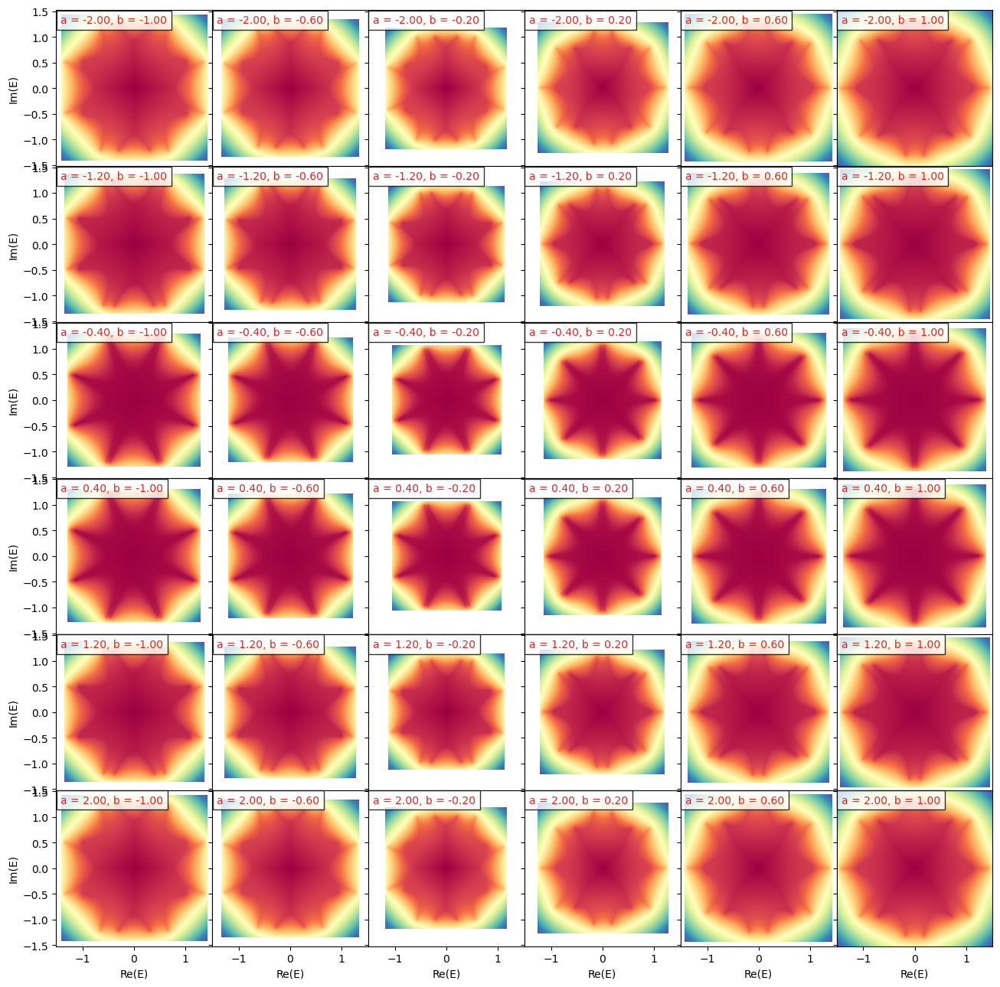

In [34]:
#| label: ChP spectral images
#| fig-cap: "a & b parameter grid of spectral potential Φ(E)"

from mpl_toolkits.axes_grid1 import ImageGrid

fig = plt.figure(figsize=(13, 13))
grid = ImageGrid(fig, 111, nrows_ncols=(6, 6), axes_pad=0, 
                 label_mode='L', share_all=True)

for ax, (i, j) in zip(grid, [(i, j) for i in range(6) for j in range(6)]):
    ax.imshow(phi_arr[i, j], extent=spectral_square[i, j], cmap='Spectral_r')
    ax.set(xlabel='Re(E)', ylabel='Im(E)')
    ax.text(
        0.03, 0.97, f'a = {a_array[i]:.2f}, b = {b_array[j]:.2f}',
        ha='left', va='top', transform=ax.transAxes,
        fontsize=10, color='tab:red',
        bbox=dict(alpha=0.8, facecolor='white')
    )

plt.tight_layout()
plt.savefig("assets/ChP-example_si.png")
plt.show()

## *Example: Reproducing gallery figure in "Zoology of non-Hermitian spectra and their graph topology" with `p2g.CharPolyClass` {#sec-gallery-example}

Above we tried to use `p2g.CharPolyClass` to construct a characteristic polynomial class $z^2 + az^-2 + bEz - E^4$, which is an intreseting while simple class. Now we can work on more challenging classes with both different coefficients and exponients.
<p align="center">
   <img src="assets/figureS13inZoology.jpg" alt="image grid of ChP" width="500"/>
   <br/>
   <em>Figure1. OBC energy spectra of ChP</em>
</p>

The figure above shows a larger class of characteristic polynomials from the paper "Zoology of non-Hermitian spectra and their graph topology" (https://arxiv.org/pdf/2202.03462). Try to plot it yourself! 

**Hint:** you can write 6 different `p2g.CharPolyClass` with the parameter $r$ and plot them by column.

In [35]:
#| label: prepare for 6 ChP
#| fig-cap: "preparation for 6 different CharPolyClass examples"

# Figure S13 with 6 CharPolyClass 
import numpy as np
import sympy as sp
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid
import poly2graph as p2g

# Basic settings
LAYER  = 'skeleton'    # 'skeleton' shows skeleton; 'potential' shows spectral potential
DEVICE = '/cpu:0'      # Use '/gpu:0' if GPU is available

# Row parameter r (in paper order)
R_VALUES = np.array([-10, -2, -1, -0.5, 0.0, 0.5, 1.0, 2.0, 10.0], dtype=float)
r_grid   = R_VALUES.reshape(-1, 1)  # (9,1)

# Symbols 
k = sp.symbols('k', real=True)
z, E = sp.symbols('z E', complex=True)
r = sp.symbols('r', real=True)


In [36]:
#| label: 6 ChP Class spectral_images
#| fig-cap: "Spectral images for 6 different CharPolyClass examples"

# 6 CharPolyClass (parameterized only by r)
# Column order strictly follows the paper: [(1,2), (2,3), (1,3), (3,4), (2,4), (1,4)]
cp12 = p2g.CharPolyClass("z**2 + 1/z + r*E**1*z - E**2", k=k, z=z, E=E, params={r})  # (g,f)=(1,2)
cp23 = p2g.CharPolyClass("z**2 + 1/z + r*E**2*z - E**3", k=k, z=z, E=E, params={r})  # (2,3)
cp13 = p2g.CharPolyClass("z**2 + 1/z + r*E**1*z - E**3", k=k, z=z, E=E, params={r})  # (1,3)
cp34 = p2g.CharPolyClass("z**2 + 1/z + r*E**3*z - E**4", k=k, z=z, E=E, params={r})  # (3,4)
cp24 = p2g.CharPolyClass("z**2 + 1/z + r*E**2*z - E**4", k=k, z=z, E=E, params={r})  # (2,4)
cp14 = p2g.CharPolyClass("z**2 + 1/z + r*E**1*z - E**4", k=k, z=z, E=E, params={r})  # (1,4)

# Compute each column at once (all shapes are (9,1,H,W) or (9,1,4)) 
phi12, dos12, bin12, ext12 = cp12.spectral_images(param_dict={r: r_grid}, device=DEVICE )
phi23, dos23, bin23, ext23 = cp23.spectral_images(param_dict={r: r_grid}, device=DEVICE)
phi13, dos13, bin13, ext13 = cp13.spectral_images(param_dict={r: r_grid}, device=DEVICE)
phi34, dos34, bin34, ext34 = cp34.spectral_images(param_dict={r: r_grid}, device=DEVICE)
phi24, dos24, bin24, ext24 = cp24.spectral_images(param_dict={r: r_grid}, device=DEVICE)
phi14, dos14, bin14, ext14 = cp14.spectral_images(param_dict={r: r_grid}, device=DEVICE)

# Concatenate all columns in paper order (9,6,H,W) 
phi_all = np.concatenate([phi12[:, :1], phi23[:, :1], phi13[:, :1],
                          phi34[:, :1], phi24[:, :1], phi14[:, :1]], axis=1)
dos_all = np.concatenate([dos12[:, :1], dos23[:, :1], dos13[:, :1],
                          dos34[:, :1], dos24[:, :1], dos14[:, :1]], axis=1)
bin_all = np.concatenate([bin12[:, :1], bin23[:, :1], bin13[:, :1],
                          bin34[:, :1], bin24[:, :1], bin14[:, :1]], axis=1)
ext_all = np.concatenate([ext12[:, :1], ext23[:, :1], ext13[:, :1],
                          ext34[:, :1], ext24[:, :1], ext14[:, :1]], axis=1)  # (9,6,4)

GF_LIST = [(1,2), (2,3), (1,3), (3,4), (2,4), (1,4)]  # For titles

Derived Bloch Hamiltonian `h_z` with 2 bands.
Derived Bloch Hamiltonian `h_z` with 3 bands.
Derived Bloch Hamiltonian `h_z` with 3 bands.
Derived Bloch Hamiltonian `h_z` with 4 bands.
Derived Bloch Hamiltonian `h_z` with 4 bands.
Derived Bloch Hamiltonian `h_z` with 4 bands.


C:\Users\ReYangonLiu\AppData\Local\Temp\ipykernel_20500\858381203.py:24: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



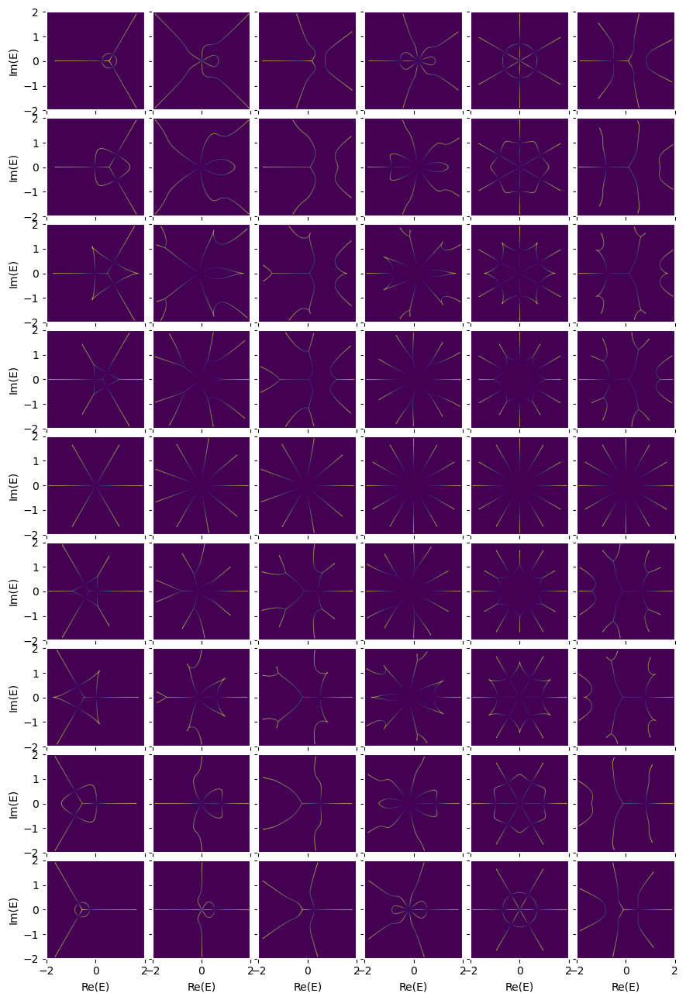

In [37]:
#| label: fig- 6 ChP
#| fig-cap: "Plotting spectral images for 6 different CharPolyClass examples"

fig = plt.figure(figsize=(13, 13))
grid = ImageGrid(fig, 111, nrows_ncols=(9, 6), axes_pad=0.1, 
                 label_mode='L', share_all=True)

# Unified coordinate range
uniform_extent = [-2, 2, -2, 2]  # [left, right, bottom, top]

for ax, (i, j) in zip(grid, [(i, j) for i in range(9) for j in range(6)]):
    # Use unified extent
    pmin, pmax = np.percentile(dos_all[i, j], (0.5, 99.5))
    # Clip extreme DOS to increase visibility
    norm = colors.Normalize(vmin=pmin, vmax=pmax)
    ax.imshow(dos_all[i, j], extent=uniform_extent, cmap='viridis', norm=norm)
    ax.set(xlabel='Re(E)', ylabel='Im(E)')
    ax.set_aspect('equal', adjustable='box')
    
    g, f = GF_LIST[j]

    plt.setp(ax.spines.values(), linewidth=1.5, color='white')

plt.tight_layout()
plt.show()

## SSH example {#sec-ssh-example}
Consider a SSH(Su–Schrieffer–Heeger) chain, which is an extremely important model for studying the fundamental properties of one-dimensional topological insulators. 
<p align="center">
   <img src="assets/ssh_connection.png" alt="SSH connection illustration" width="400"/>
   <br/>
   <em>Figure2. SSH chain with alternating hopping strengths</em>
</p>

Here solid and dashed lines in the figure mean different hopping strengths. To simplify the problem, the hopping range is limited to one.

The Bloch Hamiltonian reads
$
H(z)=
\begin{pmatrix}
0 & t_1+t_2 z \\
t_1+t_2 z^{-1} & 0
\end{pmatrix},
\qquad  z=e^{ik}.
$
In real space this corresponds to a bipartite lattice where intracell and intercell hoppings alternate along the chain.

Taking the determinant yields the characteristic polynomial
$P(z,E)=\det[H(z)-EI]
   =E^{2}-(t_1+t_2 z)(t_1+t_2 z^{-1})
   =E^{2}-(t_1^2+t_2^2+t_1 t_2(z+z^{-1})).$

We can obtain the $z(E)$ using Schrödinger Equation $H\psi = E\psi$: $
z_{\pm}(E)
=\frac{\,E^2 - t_1^2 - t_2^2 \,\pm\, 
\sqrt{(E^2 - t_1^2 - t_2^2)^2 - 4\,t_1^2 t_2^2}\,}
{\,2 t_1 t_2\,}.
$ here $z(E)$ and $\beta (E)$ are the same with different mathematical symbols.

Due to the 2 energy band of SSH model, we notice that $|\beta_p(E)|=|\beta_{p+1}(E)|$ present as $z_{-}(E) = z_{+}(E)$, thus we can define the GBZ of SSH model.

Using the equations mentioned above @sec-session-1 , we can also try to obtain the $\Phi(E)$ and $\rho(E)$ ourselves.

You can check your answer with mine: 

 $\Phi(E) = - log|t_{1}t_{2}| - log|z_{+}(E)|$,
$\rho(E) =  \frac{1}{2\pi}\nabla^2 log|z_{+}(E)|.$

Next, we can use `Poly2Graph` to check the properties of SSH model and visualize the spectral graph of it. If you are confused about the code, please refer to the previous examples @1-sec-quick-start.

In [38]:
# Always remember to define common symbols first
k = sp.symbols('k', real=True)
z, E = sp.symbols('z E', complex=True)

Here we use the string format as the initialization example.

In [39]:
# here t1, t2 = 1, 1, using P(z,E) = E^2 - (1 + z)(1 + z^-1)
# we ignore constant term to invovle non-hermicity
char_poly_str_ssh = 'E**2 - z - z**-1 '

In [40]:
sg_ssh = p2g.SpectralGraph(char_poly_str_ssh, k=k, z=z, E=E)

In [41]:
# print the number of energy bands
print('Bands:', sg_ssh.num_bands)

# print the max hopping range (p,q)
print('Max hop (right):', sg_ssh.poly_p, 'Max hop (left):', sg.poly_q)

# print the [Ereal_min,Ereal_max,Eimag_min,Eimag_max] window
print('Spectral window (auto-estimated):', sg_ssh.spectral_square) 


Bands: 2
Max hop (right): 1 Max hop (left): 4
Spectral window (auto-estimated): [-1.48274411  1.48274411 -1.48274411  1.48274411]


In [42]:
sg_ssh.ChP

Poly(-z - (1/z) + E**2, z, 1/z, E, domain='ZZ')

In [43]:
sg_ssh.h_z

Matrix([
[0, z + 1/z],
[1,       0]])

In [44]:
sg_ssh.companion_E

Matrix([
[0,   -1],
[1, E**2]])

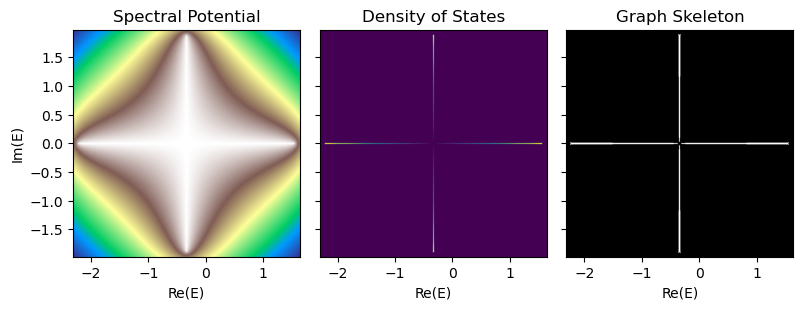

In [45]:
#| label: ssh spectral images
#| fig-cap: "Spectral images for 1 band example: (1) Spectral potential Φ, (2) Density of States ρ, (3) Graph skeleton from ρ"

phi, dos, skel = sg_ssh.spectral_images()

fig, axes = plt.subplots(1, 3, figsize=(8, 3), sharex=True, sharey=True)

# 1) Spectral potential
axes[0].imshow(phi, extent=sg.spectral_square, origin='lower', cmap='terrain')
axes[0].set(xlabel='Re(E)', ylabel='Im(E)', title='Spectral Potential')

# 2) Density of States
pmin, pmax = np.percentile(dos, (0.1, 99.9))
# Clip extreme DOS to increase visibility
norm = colors.Normalize(vmin=pmin, vmax=pmax)
axes[1].imshow(dos, extent=sg.spectral_square, cmap='viridis', norm=norm)
axes[1].set(xlabel='Re(E)', title='Density of States')

# 3) Binarized skeleton
axes[2].imshow(skel, extent=sg.spectral_square, cmap='gray')
axes[2].set(xlabel='Re(E)', title='Graph Skeleton')
plt.tight_layout()
plt.savefig("assets/ssh-example_si.png")
plt.show()